In [1]:
import os
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
from sklearn.model_selection import train_test_split

In [2]:
# Import wandb and log in
import wandb

# Log in to wandb with API key
wandb.login(key='9d4d19211298a09d6446b4e64c34b5ce5d025780')

Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: anantsharma-1839 (anantsharma-1839-op). Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: C:\Users\Asus\_netrc


True

In [3]:
# Paths
train_img_path = "dataset-lunar/craters/train/images/"
train_lbl_path = "dataset-lunar/craters/train/labels/"
valid_img_path = "dataset-lunar/craters/valid/images/"
valid_lbl_path = "dataset-lunar/craters/valid/labels/"
test_img_path = "dataset-lunar/craters/test/images/"
test_lbl_path = "dataset-lunar/craters/test/labels/"
model_path = "dataset-lunar/best.pt"
data_yaml_path = "dataset-lunar/data2.yaml"

In [4]:
# EDA and Data Preprocessing
def load_labels(label_path):
    label_files = os.listdir(label_path)
    data = []
    classes = set()
    for file in label_files:
        with open(os.path.join(label_path, file), 'r') as f:
            lines = f.readlines()
            for line in lines:
                parts = list(map(float, line.strip().split()))
                data.append([file, *parts])
                classes.add(int(parts[0]))
    df = pd.DataFrame(data, columns=['file', 'class', 'x_center', 'y_center', 'width', 'height'])
    return df, sorted(classes)

train_labels, train_classes = load_labels(train_lbl_path)
valid_labels, valid_classes = load_labels(valid_lbl_path)
test_labels, test_classes = load_labels(test_lbl_path)

In [5]:
# Get all unique classes
all_classes = sorted(set(train_classes + valid_classes + test_classes))
class_names = [f'class_{i}' for i in all_classes]

In [6]:
# Display first few rows of the labels
print("Train Labels")
print(train_labels.head())
print("\nValidation Labels")
print(valid_labels.head())
print("\nTest Labels")
print(test_labels.head())

Train Labels
                                              file  class  x_center  y_center  \
0  011_png.rf.8ac312b4898f0106d10b76952a55d237.txt    0.0  0.449219  0.076563   
1  011_png.rf.8ac312b4898f0106d10b76952a55d237.txt    0.0  0.323437  0.866406   
2  011_png.rf.8ac312b4898f0106d10b76952a55d237.txt    0.0  0.112500  0.877344   
3  011_png.rf.8ac312b4898f0106d10b76952a55d237.txt    0.0  0.752344  0.917188   
4  011_png.rf.8ac312b4898f0106d10b76952a55d237.txt    0.0  0.618750  0.135156   

      width    height  
0  0.085938  0.096094  
1  0.184375  0.177344  
2  0.215625  0.220312  
3  0.089844  0.100781  
4  0.119531  0.126562  

Validation Labels
                                              file  class  x_center  y_center  \
0  014_png.rf.6b86c8afeb3ebca92872fd966d076adc.txt    0.0  0.781250  0.070312   
1  014_png.rf.6b86c8afeb3ebca92872fd966d076adc.txt    0.0  0.099219  0.070312   
2  014_png.rf.6b86c8afeb3ebca92872fd966d076adc.txt    0.0  0.553125  0.703125   
3  014_png.rf

In [7]:
# Create data.yaml
data_yaml_content = f"""
train: {train_img_path}
val: {valid_img_path}
test: {test_img_path}

nc: {len(all_classes)}  # number of classes
names: {class_names}  # class names
"""

with open(data_yaml_path, 'w') as f:
    f.write(data_yaml_content)

In [8]:
# Plotting distribution of bounding box sizes
def plot_bounding_box_distribution(labels, title):
    labels['area'] = labels['width'] * labels['height']
    fig = px.histogram(labels, x='area', nbins=50, title=title)
    fig.show()

plot_bounding_box_distribution(train_labels, 'Train Bounding Box Area Distribution')
plot_bounding_box_distribution(valid_labels, 'Validation Bounding Box Area Distribution')
plot_bounding_box_distribution(test_labels, 'Test Bounding Box Area Distribution')

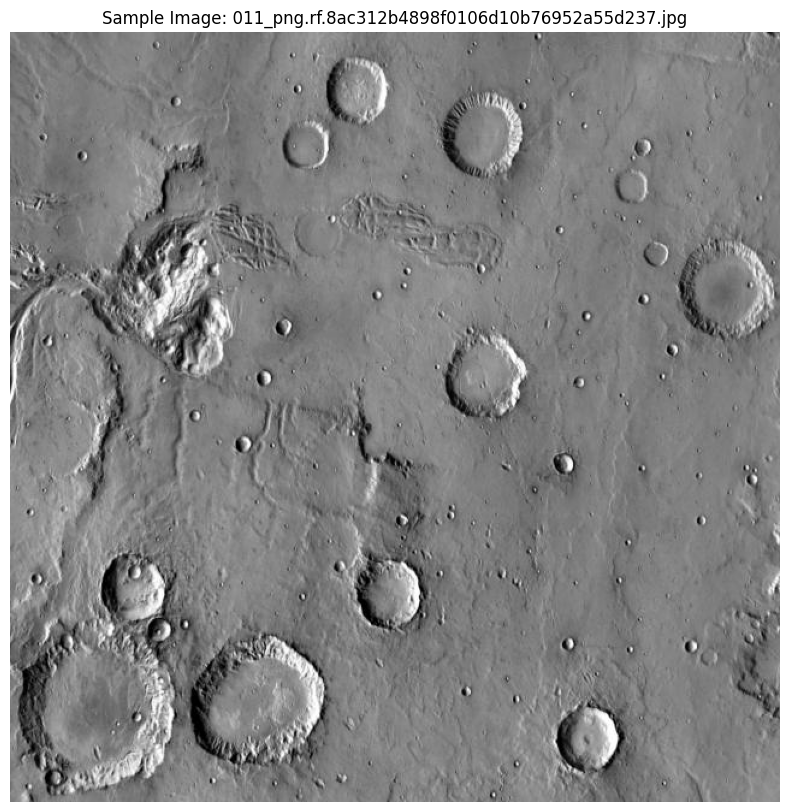

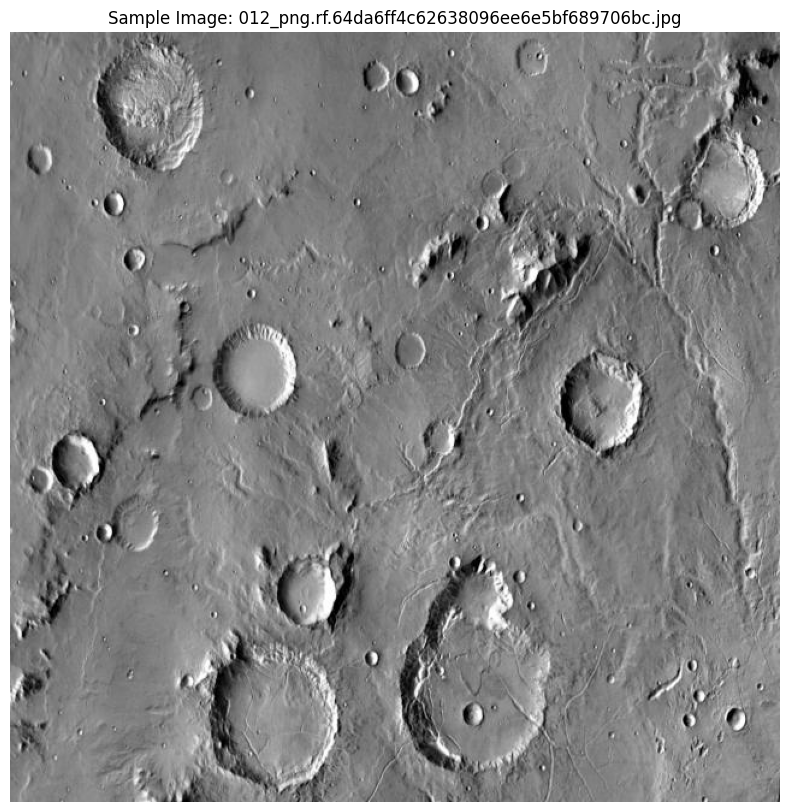

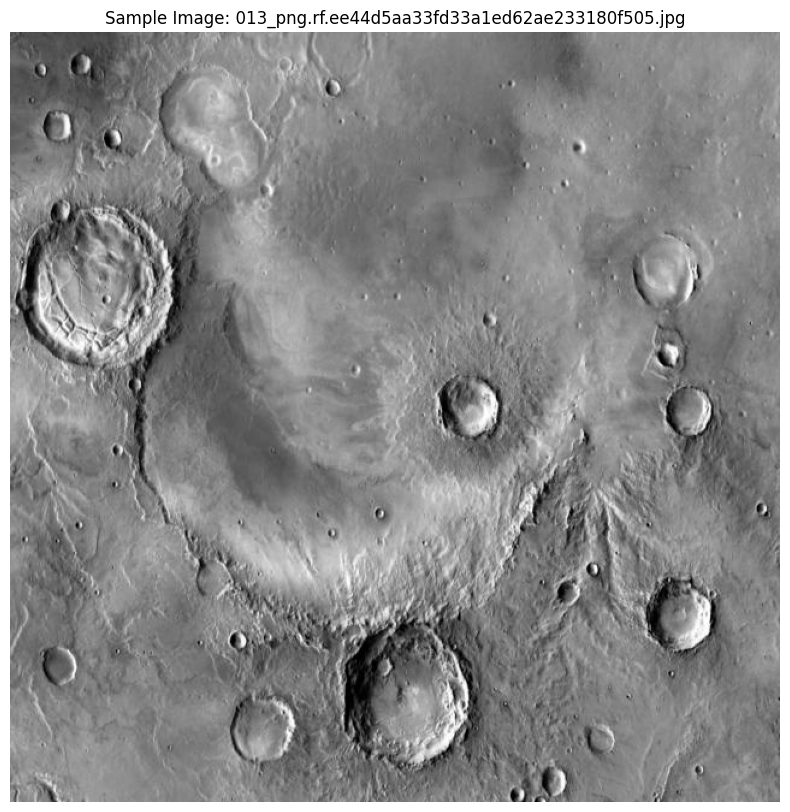

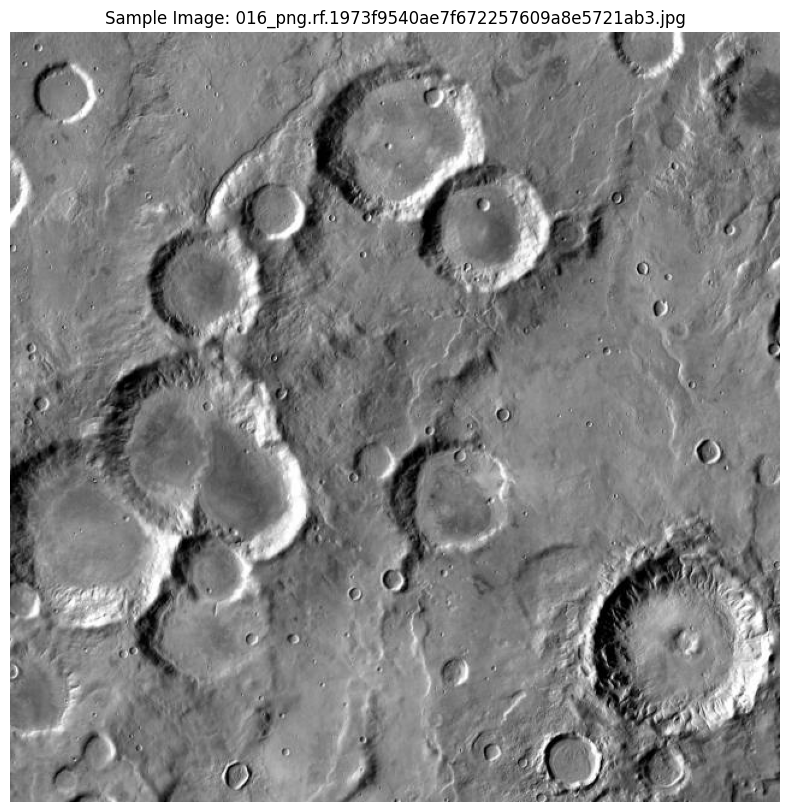

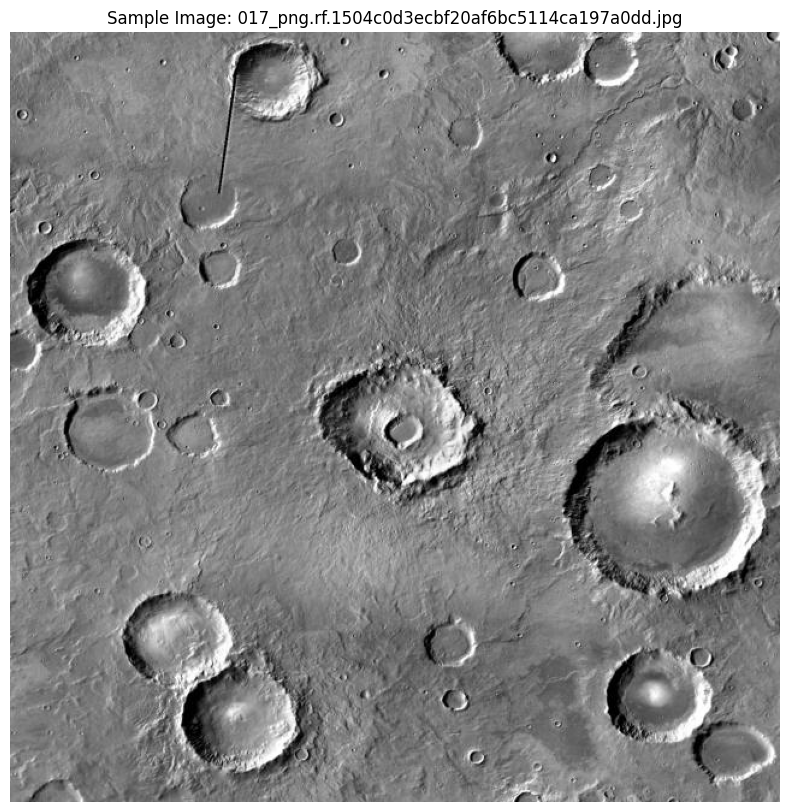

...

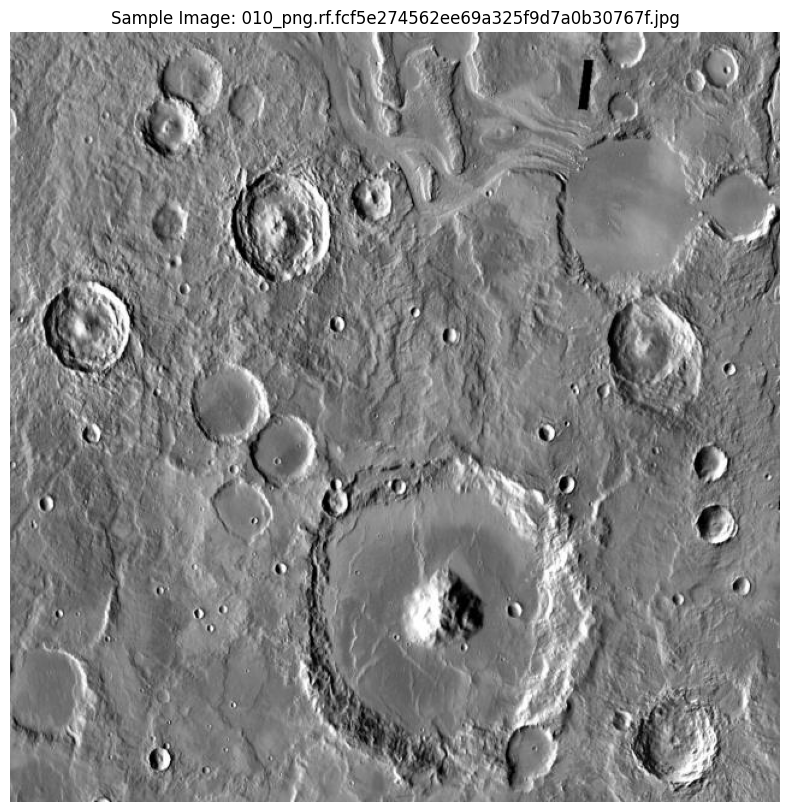

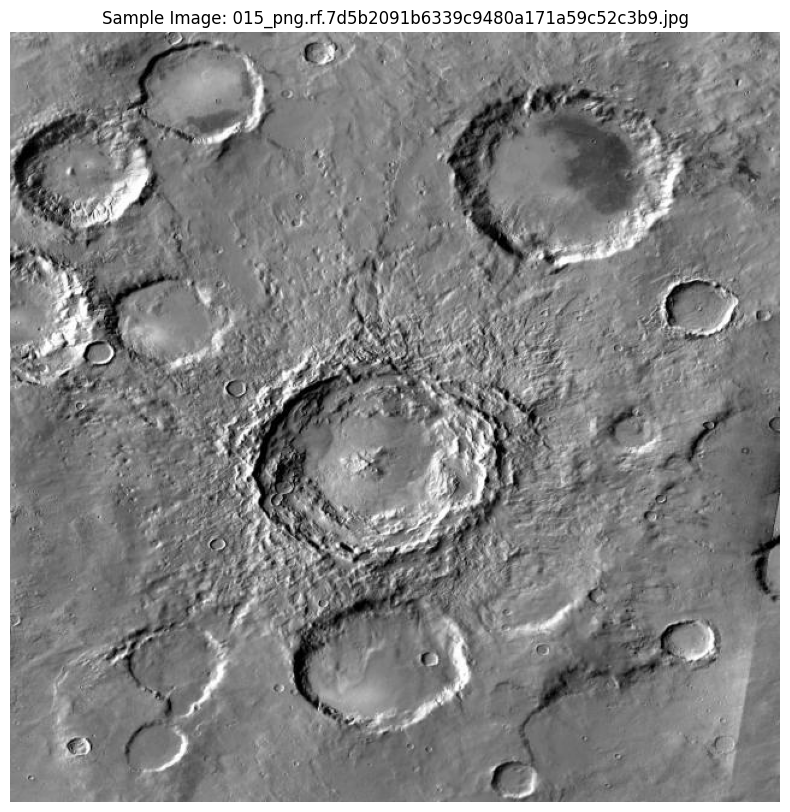

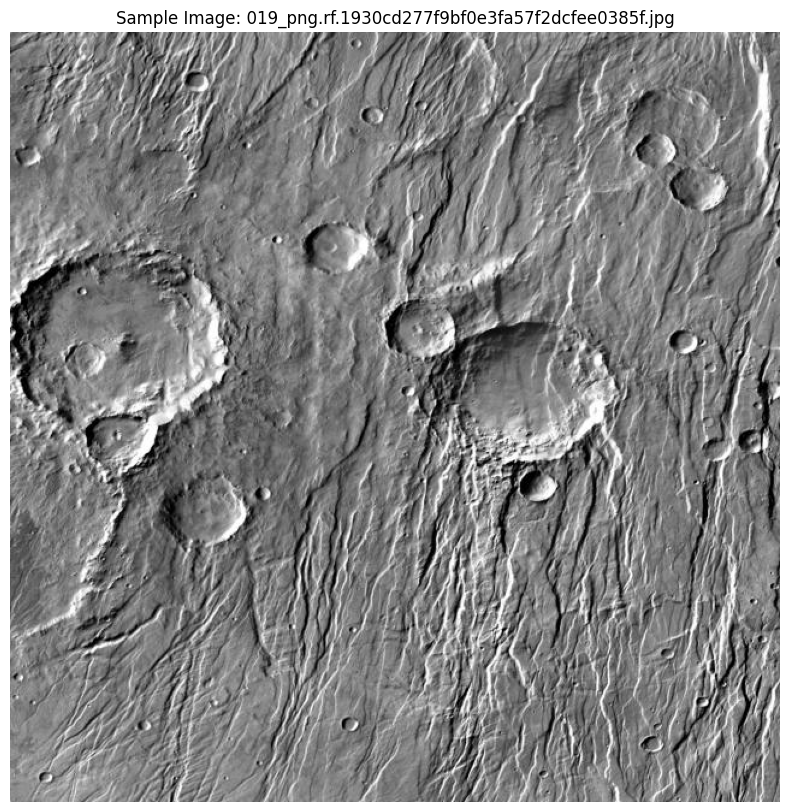

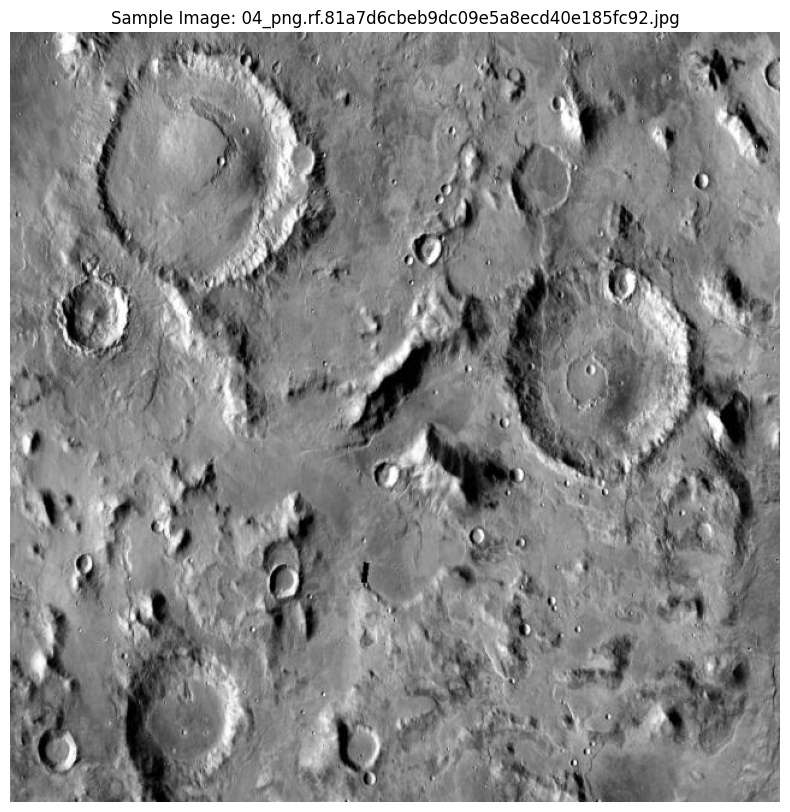

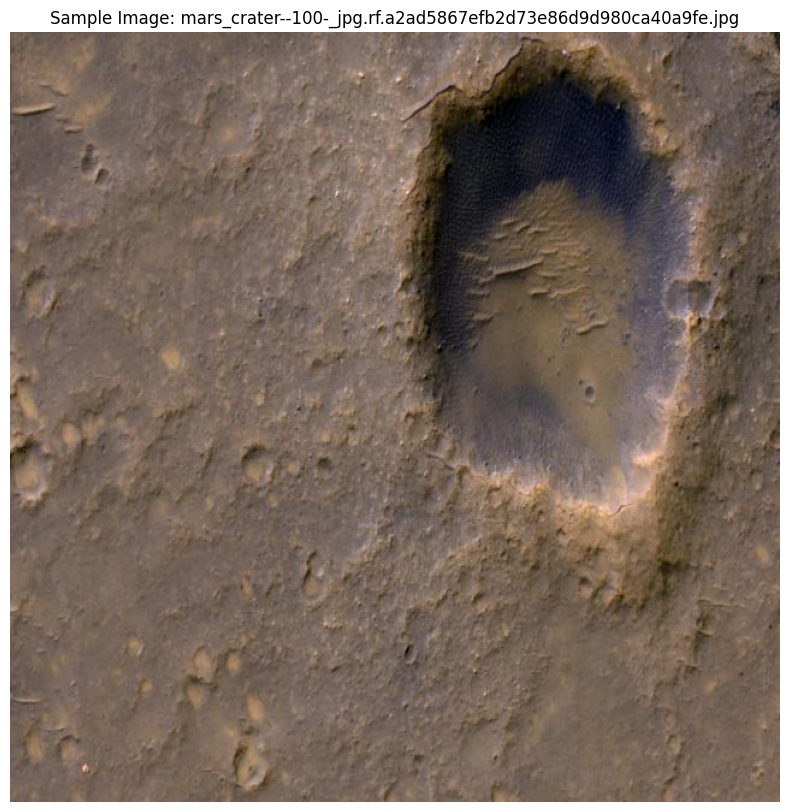

In [9]:
# Image Preprocessing and Visualization
def visualize_sample_images(image_path, label_df, n_samples=5):
    image_files = os.listdir(image_path)[:n_samples]
    for img_file in image_files:
        img_path = os.path.join(image_path, img_file)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        fig, ax = plt.subplots(1, 1, figsize=(10, 10))
        ax.imshow(img)
        
        labels = label_df[label_df['file'] == img_file]
        for _, label in labels.iterrows():
            x_center = int(label['x_center'] * img.shape[1])
            y_center = int(label['y_center'] * img.shape[0])
            width = int(label['width'] * img.shape[1])
            height = int(label['height'] * img.shape[0])
            x_min = x_center - width // 2
            y_min = y_center - height // 2
            
            rect = plt.Rectangle((x_min, y_min), width, height, edgecolor='red', facecolor='none', linewidth=2)
            ax.add_patch(rect)
        
        plt.title(f'Sample Image: {img_file}')
        plt.axis('off')
        plt.show()

visualize_sample_images(train_img_path, train_labels)
visualize_sample_images(valid_img_path, valid_labels)
visualize_sample_images(test_img_path, test_labels)

In [10]:
# YOLOv8 Model Training and Evaluation
!pip install -q ultralytics
from ultralytics import YOLO


[notice] A new release of pip is available: 24.0 -> 24.1.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [11]:
# Load the model
model = YOLO('yolov8n.pt')

In [13]:
# Train the model
model.train(data=data_yaml_path, epochs=50)

Ultralytics YOLOv8.2.60  Python-3.12.4 torch-2.3.1+cpu CPU (Intel Core(TM) i5-10300H 2.50GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=dataset-lunar/data2.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train13, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True

100%|██████████| 755k/755k [00:00<00:00, 2.78MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

Freezing layer 'model.22.dfl.conv.weight'


train: Scanning C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\train\labels...:   0%|          | 0/98 [00:00<?, ?it/s]Scanning C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\train\labels... 98 images, 9 backgrounds, 0 corrupt: 100%|██████████| 98/98 [00:00<00:00, 1488.84it/s]


train: New cache created: C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\train\labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\valid\labels...:   0%|          | 0/26 [00:00<?, ?it/s]Scanning C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\valid\labels... 26 images, 2 backgrounds, 0 corrupt: 100%|██████████| 26/26 [00:00<00:00, 501.33it/s]


val: New cache created: C:\Users\Asus\Desktop\i\react-crypto-app-master\react-crypto-app-master\isro-hackathon-2024\dataset-lunar\craters\valid\labels.cache
Plotting labels to runs\detect\train13\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs\detect\train13
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50         0G        1.9      3.447      1.461        147        640:  57%|█████▋    | 4/7 [01:42<01:21, 27.20s/it]

In [ ]:
# Evaluate the model
results = model.val()

# Save the trained model
model.save('/trained/best_model.pt')

Ultralytics YOLOv8.2.58 🚀 Python-3.10.13 torch-2.1.2+cpu CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /kaggle/input/martianlunar-crater-detection-dataset/craters/valid/labels... 26 images, 2 backgrounds, 0 corrupt: 100%|██████████| 26/26 [00:00<00:00, 631.69it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/martianlunar-crater-detection-dataset/craters/valid is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:06<00:00,  3.48s/it]


                   all         26        202      0.702      0.595      0.687      0.381
Speed: 2.5ms preprocess, 251.8ms inference, 0.0ms loss, 4.7ms postprocess per image
Results saved to runs/detect/train2



image 1/1 /kaggle/input/martianlunar-crater-detection-dataset/craters/test/images/mars_crater--100-_jpg.rf.a2ad5867efb2d73e86d9d980ca40a9fe.jpg: 640x640 5 class_0s, 206.6ms
Speed: 2.8ms preprocess, 206.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


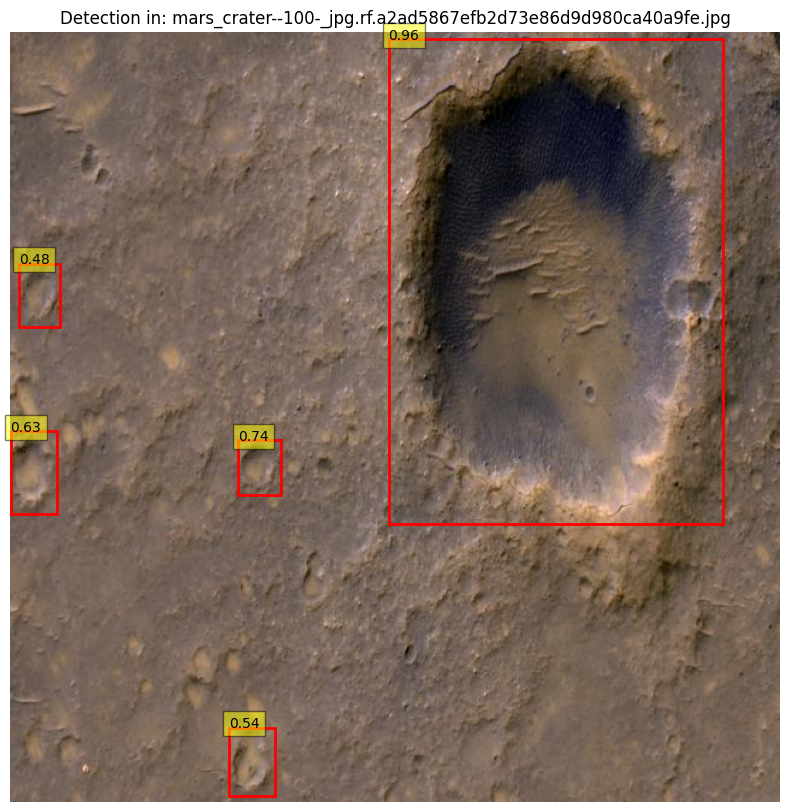


image 1/1 /kaggle/input/martianlunar-crater-detection-dataset/craters/test/images/mars_crater--51-_jpg.rf.2f21cd1782f9da8bb8f1ada8efa134a7.jpg: 640x640 2 class_0s, 206.3ms
Speed: 2.9ms preprocess, 206.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


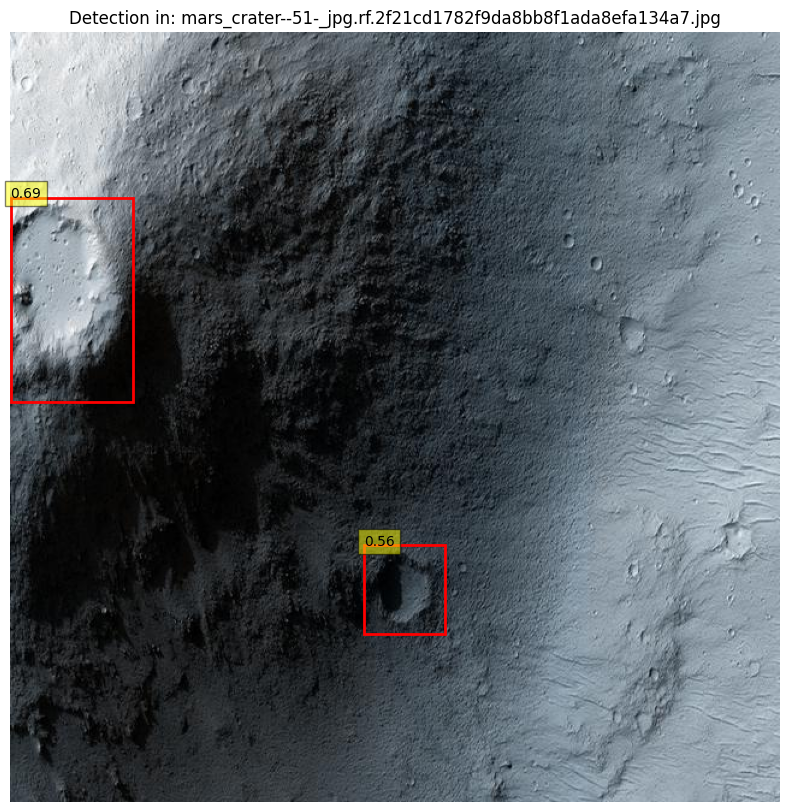


image 1/1 /kaggle/input/martianlunar-crater-detection-dataset/craters/test/images/015_png.rf.7d5b2091b6339c9480a171a59c52c3b9.jpg: 640x640 15 class_0s, 209.7ms
Speed: 3.0ms preprocess, 209.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


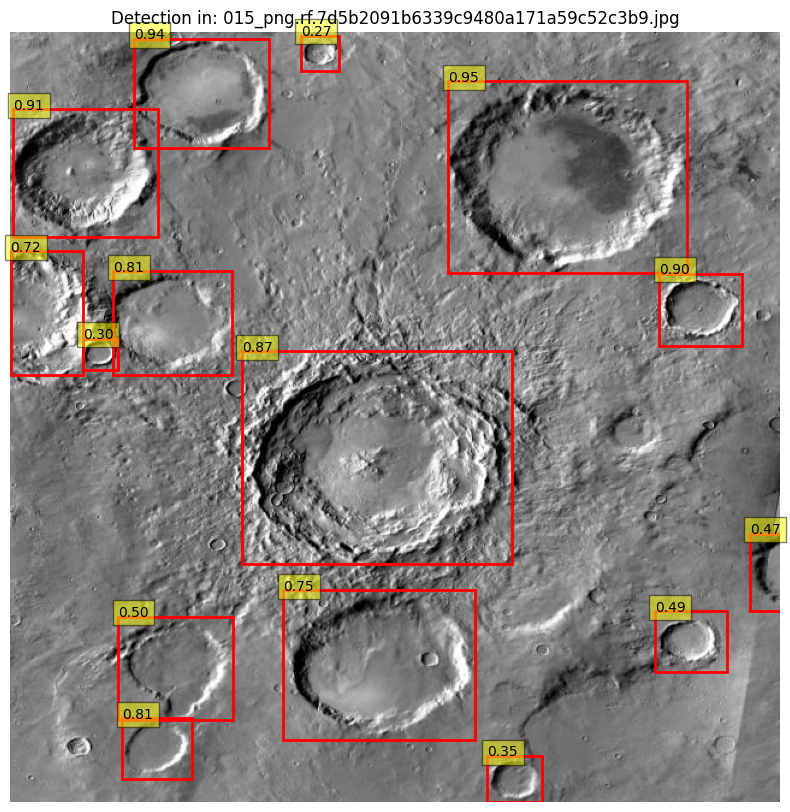


image 1/1 /kaggle/input/martianlunar-crater-detection-dataset/craters/test/images/04_png.rf.81a7d6cbeb9dc09e5a8ecd40e185fc92.jpg: 640x640 15 class_0s, 209.7ms
Speed: 2.9ms preprocess, 209.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


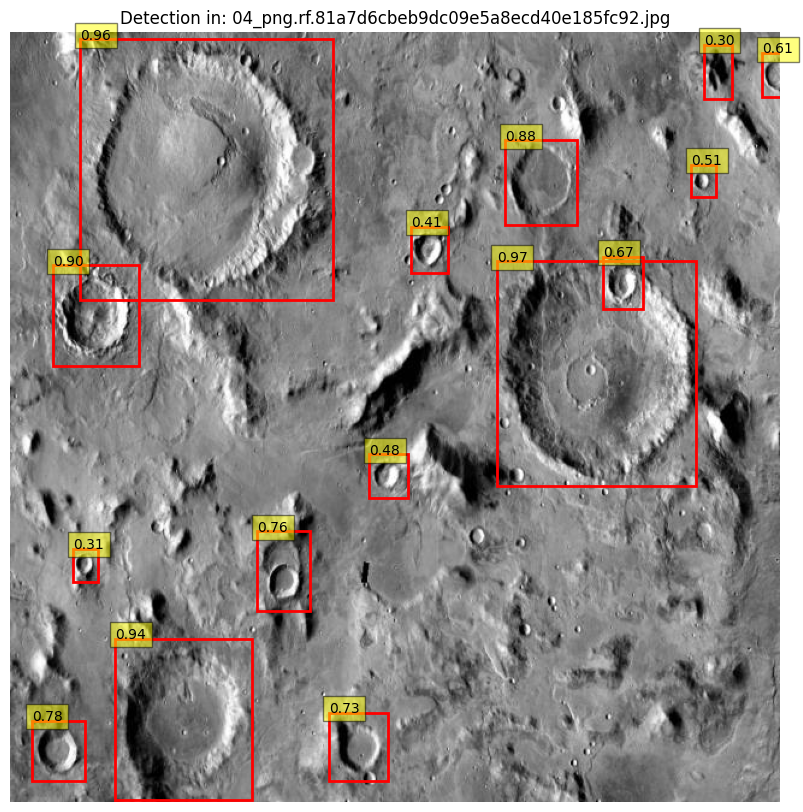


image 1/1 /kaggle/input/martianlunar-crater-detection-dataset/craters/test/images/mars_crater--117-_jpg.rf.b412b6593d102c5f9dda7bce79bb815c.jpg: 640x640 9 class_0s, 208.7ms
Speed: 3.8ms preprocess, 208.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


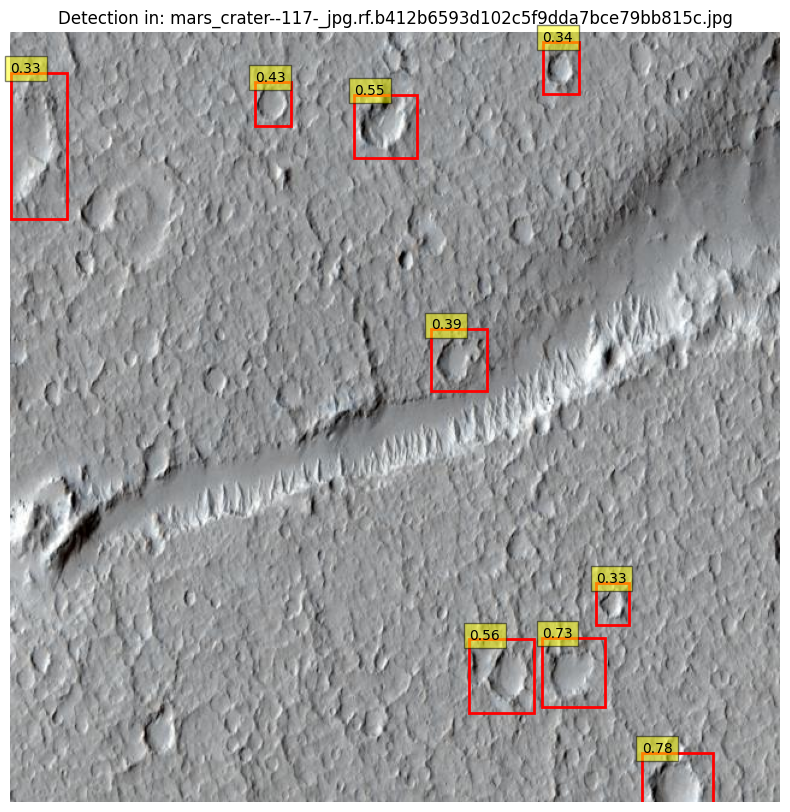


image 1/1 /kaggle/input/martianlunar-crater-detection-dataset/craters/test/images/mars_crater--116-_jpg.rf.2e550a693a8800808e68848484716b95.jpg: 640x640 5 class_0s, 209.1ms
Speed: 3.1ms preprocess, 209.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


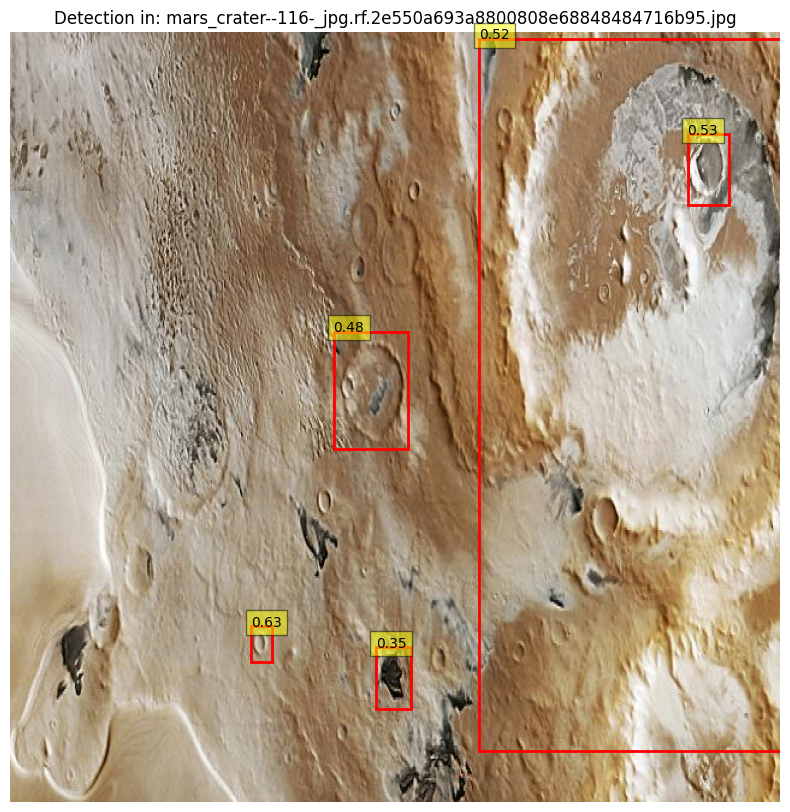


image 1/1 /kaggle/input/martianlunar-crater-detection-dataset/craters/test/images/mars_crater--33-_jpg.rf.baf9c7be01ba1f4b954e0e5be0560c80.jpg: 640x640 1 class_0, 207.2ms
Speed: 2.8ms preprocess, 207.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


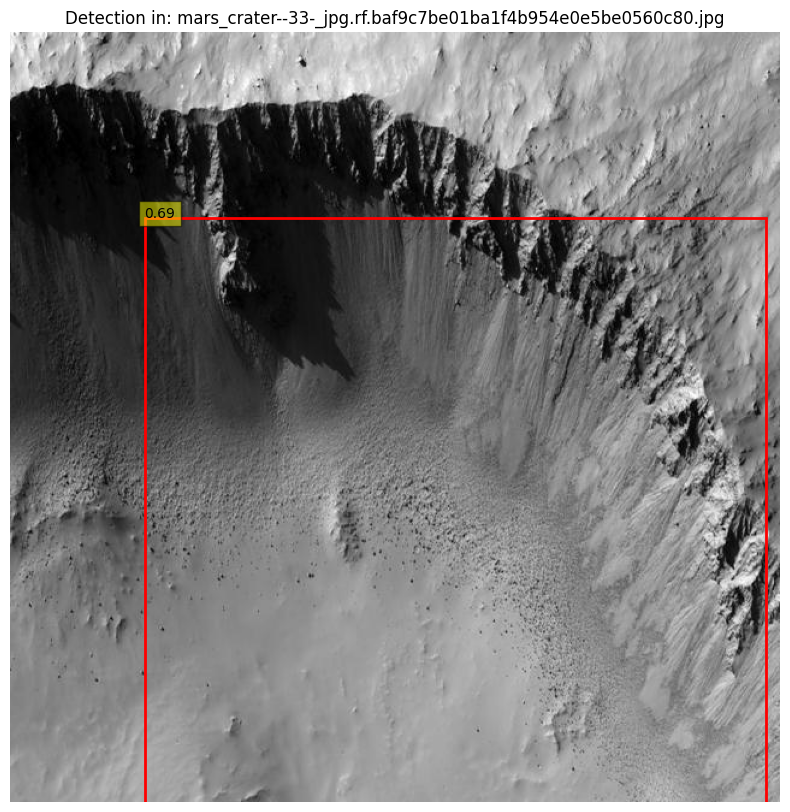


image 1/1 /kaggle/input/martianlunar-crater-detection-dataset/craters/test/images/mars_crater--65-_jpg.rf.34ab64f1f6ce5a4b360ea66eae77d4b9.jpg: 640x640 6 class_0s, 234.3ms
Speed: 2.8ms preprocess, 234.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


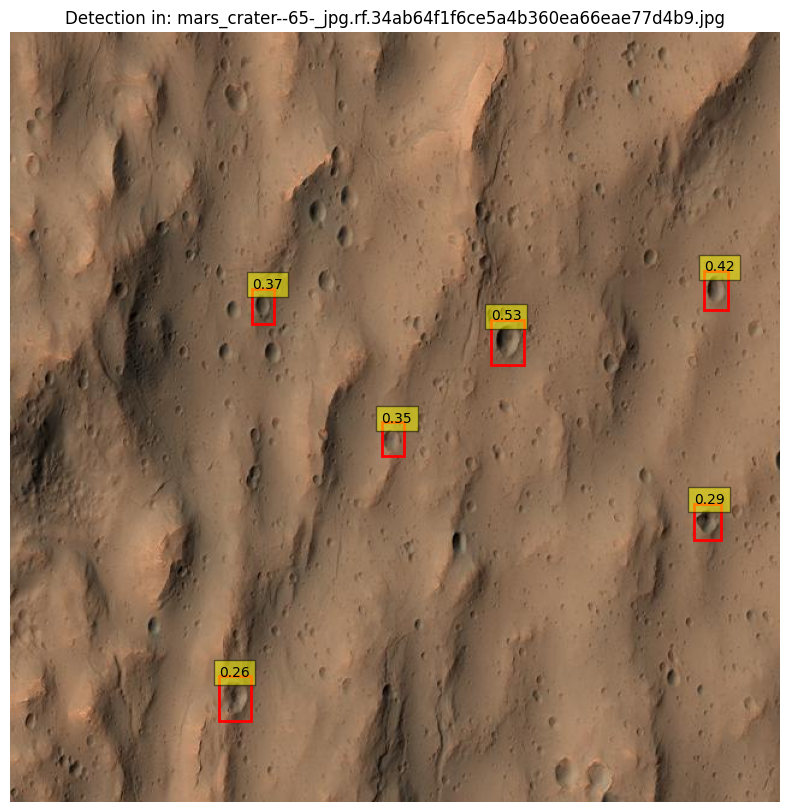


image 1/1 /kaggle/input/martianlunar-crater-detection-dataset/craters/test/images/mars_crater--46-_jpg.rf.369e88a43859f97a595d2091746600f4.jpg: 640x640 1 class_0, 209.0ms
Speed: 2.8ms preprocess, 209.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


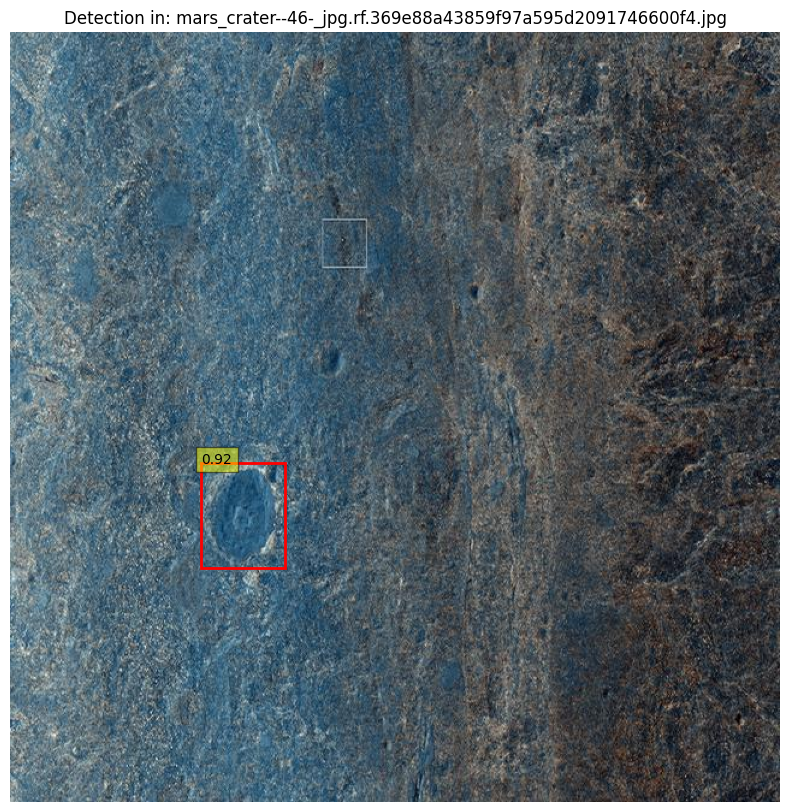


image 1/1 /kaggle/input/martianlunar-crater-detection-dataset/craters/test/images/mars_crater--25-_jpg.rf.a06bfa24b404b064ead471f56d636e0e.jpg: 640x640 6 class_0s, 209.3ms
Speed: 3.1ms preprocess, 209.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


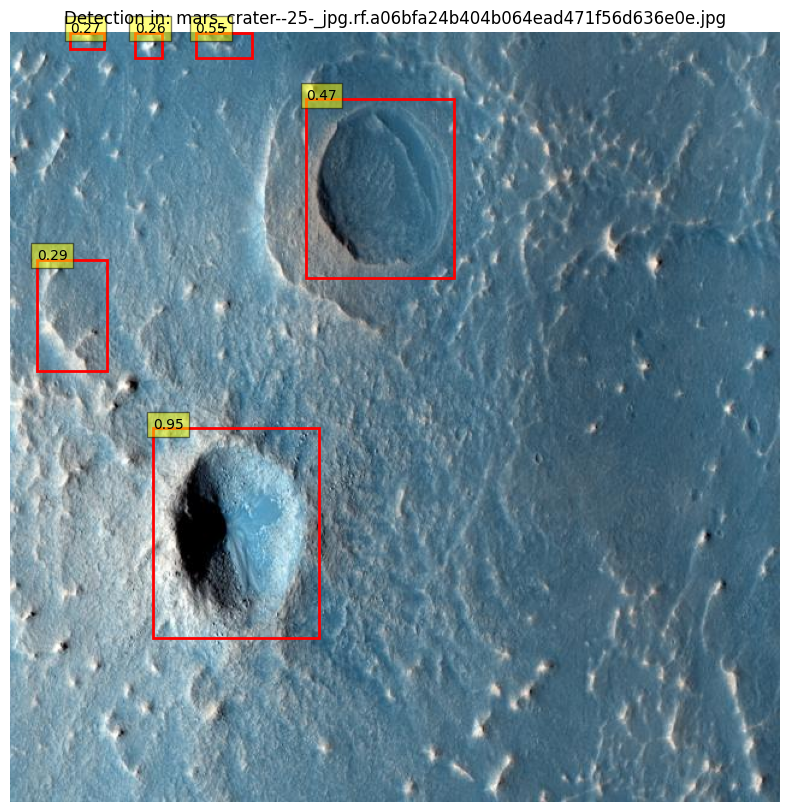

Model training, evaluation, and sample visualization completed. The trained model is saved at '/kaggle/working/best_model.pt'.


In [ ]:
# Visualize sample detections
def visualize_detections(model, image_path, n_samples=10):
    image_files = os.listdir(image_path)[:n_samples]
    for img_file in image_files:
        img_path = os.path.join(image_path, img_file)
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        results = model(img_path)
        
        fig, ax = plt.subplots(1, 1, figsize=(10, 10))
        ax.imshow(img)
        
        for result in results[0].boxes:
            x_min, y_min, x_max, y_max = result.xyxy[0].tolist()
            conf = result.conf[0].item()
            rect = plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min, edgecolor='red', facecolor='none', linewidth=2)
            ax.add_patch(rect)
            ax.text(x_min, y_min, f'{conf:.2f}', bbox=dict(facecolor='yellow', alpha=0.5))
        
        plt.title(f'Detection in: {img_file}')
        plt.axis('off')
        plt.show()

visualize_detections(model, test_img_path)

print("Model training, evaluation, and sample visualization completed. The trained model is saved at '/kaggle/working/best_model.pt'.")